# Analysis of item vectors with TSNE and PCA


In [1]:
import pickle
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from sklearn.model_selection import train_test_split
import pandas as pd
import time 

from bokeh.io import output_file, output_notebook
import bokeh.plotting as bpl
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource
from bokeh.layouts import row, column, gridplot
from bokeh.models.widgets import Tabs, Panel
import bokeh.models as bmo
from bokeh.plotting import reset_output
import gzip
from bokeh.palettes import d3, Magma256, Plasma256
from collections import OrderedDict
from bokeh.models import HoverTool

%matplotlib inline

## Load Metadata

In [14]:
df = pd.read_json(r'D:\Datasets\amazon_reviews\processed\reviews_Video_Games_5.json')
df_train, df_test = train_test_split(df, test_size = 0.3, stratify=df['reviewerID'], random_state=42)

U_V_PATH = 'D:/Models/thesis/sdae-sgd/sdae_sgd_optim_video_games_10/pickles/'
with open(U_V_PATH + 'asins_map.pickle', 'rb') as handle:
    asins_map = pickle.load(handle)

In [17]:
len(asins_map)

10668

In [18]:
def parse(path):
    g = gzip.open(path, 'rb')
    for l in g:
        yield eval(l)

def get_dataframe(path):
    i = 0
    df = {}
    for d in parse(path):
        df[i] = d
        i += 1
    return pd.DataFrame.from_dict(df, orient='index')

df_meta = get_dataframe('D:/Datasets/amazon_reviews/gzips/meta_Video_Games.json.gz')

In [19]:
df_meta.head(2)

,imUrl,description,related,categories,salesRank,price,asin,title,brand
0,http://ecx.images-amazon.com/images/I/513h6dPb...,Brand new sealed!,"{'buy_after_viewing': ['B0050SY5BM', 'B000TI83...","[[Video Games, Xbox 360, Games]]",{'Video Games': 28655},37.98,0078764343,NaN,NaN
1,http://ecx.images-amazon.com/images/I/61KKRndV...,In Stock NOW. Eligible for FREE Super Saving ...,"{'buy_after_viewing': ['B000067NP1', '04395739...","[[Video Games, PC, Games]]",{'Video Games': 44080},23.50,043933702X,NaN,NaN


In [20]:
df_meta.shape

(50953, 9)

In [21]:
df_train.shape

(162246, 11)

In [22]:
asins_map_rev = {v:k for k,v in asins_map.items()}

In [23]:
len(asins_map_rev)

10668

## Load Item Vectors

In [24]:
with open(U_V_PATH + 'mx.pickle', 'rb') as handle:
    mats = pickle.load(handle)

In [25]:
qi = mats['qi']

In [26]:
qi.shape

(10668, 10)

In [27]:
df_map = {}
for i, d in enumerate(qi):
    df_map[i] = asins_map_rev[i]

df_vec = pd.DataFrame.from_dict(df_map, orient='index')

In [28]:
df_vec = df_vec.rename(columns={0: 'asin'})

In [29]:
df_vec.head()

,asin
0,B002WSR8CQ
1,B000X1TC0U
2,B00063BLG8
3,B003VWGBCK
4,B000IZAQD8


In [30]:
reviews = pd.DataFrame(df.groupby('asin')['summary'].agg('\n'.join))

In [31]:
reviews.head(2)

,summary
asin,
0700099867,Pay to unlock content? I don't think so.\nGood...
6050036071,Works good!\nYet Another Great Expansion\nUSB ...


In [32]:
from textblob import TextBlob

In [33]:
def sentiment(s):
    blob = TextBlob(s)
    return blob.sentiment.polarity

In [34]:
reviews['sentiment'] = reviews['summary'].apply(sentiment)

In [35]:
bins = [-1, -0.75, -0.5, -0.25, 0, 0.25, 0.5, 0.75, 1]
group_names = ['super neg', 'very neg','neg', 'slightly neg', 'slightly pos', 'pos','very pos', 'super pos']
reviews['sentiment_str'] = pd.cut(reviews['sentiment'], bins, labels=group_names).astype(str)

In [36]:
reviews.head(2)

,summary,sentiment,sentiment_str
asin,,,
0700099867,Pay to unlock content? I don't think so.\nGood...,0.208861,slightly pos
6050036071,Works good!\nYet Another Great Expansion\nUSB ...,0.475893,pos


In [37]:
new_df = pd.merge(df_vec,  df_meta,  how='left', left_on=['asin'], right_on = ['asin'])

In [38]:
new_df = pd.merge(new_df, reviews, how = 'left', on=['asin'])

In [39]:
new_df.head(2)

,asin,imUrl,description,related,categories,salesRank,price,title,brand,summary,sentiment,sentiment_str
0,B002WSR8CQ,http://ecx.images-amazon.com/images/I/5159N%2B...,"Backbreaker is the full-on 11 vs. 11, high-imp...","{'buy_after_viewing': ['B0047OOEFM', 'B000WSB0...","[[Video Games, Kids & Family, PlayStation 3, G...",{'Video Games': 10209},19.99,NaN,NaN,"I tried, but.......\nEh...not feeling it.\nVER...",0.076364,slightly pos
1,B000X1TC0U,http://ecx.images-amazon.com/images/I/51byOFTw...,Dead Space from EA is sure to please any actio...,"{'buy_after_viewing': ['B0050SWUTQ', 'B007CM0K...","[[Video Games, PlayStation 3]]",{'Video Games': 2020},19.99,NaN,NaN,Go For It !!!\nToo dark. Too hard.\nLove it\n...,0.097092,slightly pos


In [40]:
new_df['2nd_cat'] = new_df.apply(lambda row: row['categories'][0][1] if len(row['categories'][0]) > 1 else None, axis = 1)

In [41]:
new_df.head(2)

,asin,imUrl,description,related,categories,salesRank,price,title,brand,summary,sentiment,sentiment_str,2nd_cat
0,B002WSR8CQ,http://ecx.images-amazon.com/images/I/5159N%2B...,"Backbreaker is the full-on 11 vs. 11, high-imp...","{'buy_after_viewing': ['B0047OOEFM', 'B000WSB0...","[[Video Games, Kids & Family, PlayStation 3, G...",{'Video Games': 10209},19.99,NaN,NaN,"I tried, but.......\nEh...not feeling it.\nVER...",0.076364,slightly pos,Kids & Family
1,B000X1TC0U,http://ecx.images-amazon.com/images/I/51byOFTw...,Dead Space from EA is sure to please any actio...,"{'buy_after_viewing': ['B0050SWUTQ', 'B007CM0K...","[[Video Games, PlayStation 3]]",{'Video Games': 2020},19.99,NaN,NaN,Go For It !!!\nToo dark. Too hard.\nLove it\n...,0.097092,slightly pos,PlayStation 3


In [42]:
new_df['2nd_cat'].unique()

array(['Kids & Family', 'PlayStation 3', 'Mac', 'Wii', 'More Systems',
       'PC', 'Digital Games', 'Xbox 360', None, 'PlayStation 4',
       'Nintendo 3DS', 'Television & Video', 'Sony PSP',
       'Electronics for Kids', 'Computers & Accessories', 'Nintendo DS',
       'Wii U', 'Team Sports', 'PlayStation Vita', 'Xbox One',
       'Car & Vehicle Electronics', 'Hunting & Fishing', 'Fan Shop',
       'Accessories & Supplies', 'Gift Cards', 'Games',
       'Accounting & Finance', 'Office Electronics',
       'Action Figures & Statues', "Children's", 'Geography',
       'Camera & Photo', 'TV', 'eBook Readers & Accessories',
       'Kindle Accessories', 'Tax Preparation', 'Accessories',
       'Design & Illustration', 'Rough Plumbing',
       'Leisure Sports & Game Room', 'Soundtracks', 'Metal',
       'Craft Supplies', 'Alternative Rock', 'Business & Office',
       'Portable Audio & Video', 'Education & Reference'], dtype=object)

In [43]:
new_df['sentiment_str'].unique().shape

(8,)

### PCA

In [44]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(qi)
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [0.16385496 0.13966613 0.13368976]


In [45]:
new_df['pca-one'] = pca_result[:,0]
new_df['pca-two'] = pca_result[:,1] 

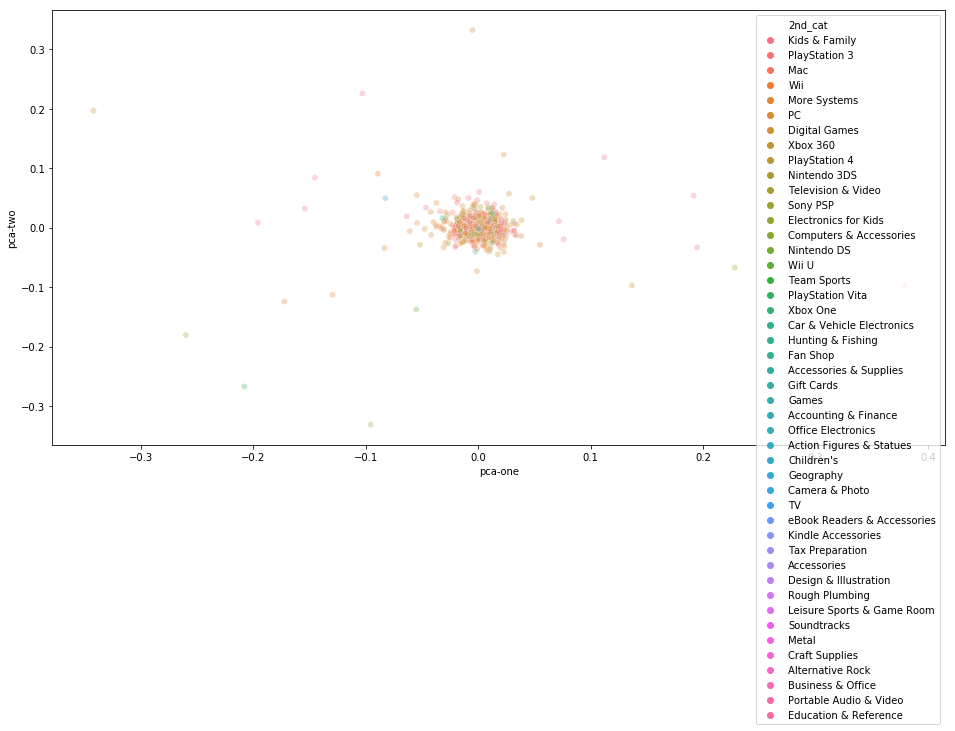

In [46]:
plt.figure(figsize = (16, 8))
sns.scatterplot(
    x='pca-one', y='pca-two',
    hue='2nd_cat',
    data=new_df,
    legend="full",
    alpha=0.3
)

In [47]:
new_df['2nd_cat'].value_counts()[0:20]

Kids & Family              2559
More Systems               2255
PC                         1643
Xbox 360                   1020
PlayStation 3               868
Digital Games               492
Wii                         405
Sony PSP                    230
Nintendo 3DS                226
Nintendo DS                 171
Mac                         118
Fan Shop                    101
PlayStation Vita             94
Computers & Accessories      59
Games                        55
Electronics for Kids         49
Wii U                        40
Xbox One                     38
PlayStation 4                36
Children's                   29
Name: 2nd_cat, dtype: int64

In [48]:
ff = new_df[new_df['2nd_cat'].isin(new_df['2nd_cat'].value_counts()[0:20].index.values)]

In [291]:
ff = new_df[new_df['2nd_cat'].isin(['Games', 'PC', 'Mac'])]

In [49]:
ff['2nd_cat'].unique().shape

(20,)

In [288]:
ff = ff.sample(500)

In [50]:
output_notebook()

# bokeh
source = bpl.ColumnDataSource.from_df(ff[['pca-one', 'pca-two', '2nd_cat', 'title', 'description', 'sentiment_str', 'sentiment' ,'price', 'summary']])

# use whatever palette you want...
coloring_label = 'sentiment_str'
palette = d3['Category20'][len(ff[coloring_label].unique())]
color_map = bmo.CategoricalColorMapper(factors=ff[coloring_label].unique(), 
                                       palette=palette)

# create figure and plot
TOOLS="pan,wheel_zoom,box_zoom,reset,hover,previewsave"

TOOLTIPS = [
    ("desc", "@{summary}"),
    ("sentiment", '@{sentiment}'),
    ('price', '@{price}')
]

fig = figure(tools=TOOLS,tooltips=TOOLTIPS, plot_width=1000, plot_height=800)
fig.scatter(x='pca-one', y='pca-two', source=source,
            color={'field': coloring_label, 'transform': color_map},
            legend=coloring_label)
    
show(fig)

Loading BokehJS ...

In [51]:
reset_output()

## Original Dimensions

In [62]:
new_df['one'] = qi[:,3]
new_df['two'] = qi[:,4] 


ff = new_df[new_df['2nd_cat'].isin(new_df['2nd_cat'].value_counts()[0:20].index.values)]
ff = ff.sample(2000)

In [63]:
ff['sentiment_str'].unique()

array(['slightly pos', 'pos', 'slightly neg', 'very pos', 'super pos',
       'neg', 'very neg', 'super neg'], dtype=object)

In [64]:
output_notebook()

# bokeh
source = bpl.ColumnDataSource.from_df(ff[['one', 'two', '2nd_cat', 'title', 'description', 'sentiment_str', 'sentiment' ,'price', 'summary']])

# use whatever palette you want...
coloring_label = '2nd_cat'
palette = d3['Category20'][len(ff[coloring_label].unique())]
color_map = bmo.CategoricalColorMapper(factors=ff[coloring_label].unique(), 
                                       palette=palette)

# create figure and plot
TOOLS="pan,wheel_zoom,box_zoom,reset,hover,previewsave"

TOOLTIPS = [
    ("desc", "@{summary}"),
    ("sentiment", '@{sentiment}'),
    ('price', '@{price}')
]

fig = figure(tools=TOOLS,tooltips=TOOLTIPS, plot_width=1000, plot_height=800)
fig.scatter(x='one', y='two', source=source,
            color={'field': coloring_label, 'transform': color_map},
            legend=coloring_label)
    
show(fig)

Loading BokehJS ...

## TSNE

In [65]:
time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=20, n_iter=2000)
tsne_results = tsne.fit_transform(qi)
print('t-SNE done! Time elapsed: {} seconds'.format(time.time() - time_start))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 10668 samples in 0.013s...
[t-SNE] Computed neighbors for 10668 samples in 2.466s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10668
[t-SNE] Computed conditional probabilities for sample 2000 / 10668
[t-SNE] Computed conditional probabilities for sample 3000 / 10668
[t-SNE] Computed conditional probabilities for sample 4000 / 10668
[t-SNE] Computed conditional probabilities for sample 5000 / 10668
[t-SNE] Computed conditional probabilities for sample 6000 / 10668
[t-SNE] Computed conditional probabilities for sample 7000 / 10668
[t-SNE] Computed conditional probabilities for sample 8000 / 10668
[t-SNE] Computed conditional probabilities for sample 9000 / 10668
[t-SNE] Computed conditional probabilities for sample 10000 / 10668
[t-SNE] Computed conditional probabilities for sample 10668 / 10668
[t-SNE] Mean sigma: 0.001837
[t-SNE] KL divergence after 50 iterations with early exaggeration: 100.373611
[t-SNE] Err

In [66]:
new_df['tsne-one'] = tsne_results[:,0]
new_df['tsne-two'] = tsne_results[:,1] 

In [68]:
new_df['2nd_cat'].value_counts()[0:20].index.values

array(['Kids & Family', 'More Systems', 'PC', 'Xbox 360', 'PlayStation 3',
       'Digital Games', 'Wii', 'Sony PSP', 'Nintendo 3DS', 'Nintendo DS',
       'Mac', 'Fan Shop', 'PlayStation Vita', 'Computers & Accessories',
       'Games', 'Electronics for Kids', 'Wii U', 'Xbox One',
       'PlayStation 4', "Children's"], dtype=object)

In [69]:
ff = new_df[new_df['2nd_cat'].isin(new_df['2nd_cat'].value_counts()[0:20].index.values)]

In [353]:
ff = new_df[new_df['brand'].isin(['Mattel', 'Fisher-Price', 'LEGO', 'Melissa &amp; Doug', 'Hasbro', 'LeapFrog Enterprises', 'VTech', 'Transformers', 'Crayola'])]

In [70]:
ff.head(2)

,asin,imUrl,description,related,categories,salesRank,price,title,brand,summary,sentiment,sentiment_str,2nd_cat,pca-one,pca-two,one,two,tsne-one,tsne-two
0,B002WSR8CQ,http://ecx.images-amazon.com/images/I/5159N%2B...,"Backbreaker is the full-on 11 vs. 11, high-imp...","{'buy_after_viewing': ['B0047OOEFM', 'B000WSB0...","[[Video Games, Kids & Family, PlayStation 3, G...",{'Video Games': 10209},19.99,NaN,NaN,"I tried, but.......\nEh...not feeling it.\nVER...",0.076364,slightly pos,Kids & Family,-0.001882,0.004663,-0.010146,0.001007,-68.273071,-55.583767
1,B000X1TC0U,http://ecx.images-amazon.com/images/I/51byOFTw...,Dead Space from EA is sure to please any actio...,"{'buy_after_viewing': ['B0050SWUTQ', 'B007CM0K...","[[Video Games, PlayStation 3]]",{'Video Games': 2020},19.99,NaN,NaN,Go For It !!!\nToo dark. Too hard.\nLove it\n...,0.097092,slightly pos,PlayStation 3,-0.000002,-0.000071,-0.000510,-0.000067,-14.341524,61.873093


In [73]:
output_notebook()

# bokeh
source = bpl.ColumnDataSource.from_df(ff[['tsne-one', 'tsne-two', '2nd_cat', 'title', 'description', 'sentiment_str', 'sentiment' ,'price', 'summary']])

# use whatever palette you want...
coloring_label = '2nd_cat'
palette = d3['Category20'][len(ff[coloring_label].unique())]
color_map = bmo.CategoricalColorMapper(factors=ff[coloring_label].unique(), 
                                       palette=palette)

# create figure and plot
TOOLS="pan,wheel_zoom,box_zoom,reset,hover,previewsave"

TOOLTIPS = [
    ("desc", "@{summary}"),
    ("sentiment", '@{sentiment}'),
    ('price', '@{price}')
]

fig = figure(tools=TOOLS,tooltips=TOOLTIPS,plot_width=1000, plot_height=800)
fig.scatter(x='tsne-one', y='tsne-two', source=source,
            color={'field': coloring_label, 'transform': color_map},
            legend=coloring_label)
    
show(fig)

Loading BokehJS ...

In [74]:
reset_output()

### Find similar items

In [75]:
from sklearn.metrics.pairwise import cosine_similarity

In [79]:
cosim = cosine_similarity(qi, qi)

In [86]:
idx = (-cosim[0]).argsort()[:10]

In [162]:
i = 0
similar_items = {}
for arr in cosim:
    idx = (-arr).argsort()[1:101]
    items = [asins_map_rev[index] for index in idx]
    similar_items[asins_map_rev[i]] = items
    i += 1

In [163]:
def print_item(item_meta):
    print('Asin', item_meta['asin'])
    #print('Description', item_meta['description'])
    print('Related:', item_meta['related'])
    print('Categories:', item_meta['categories'])
    #print('Price:', item_meta['price'])

In [164]:
def print_simitems(item, simitems):
    item_meta = df_meta.loc[df_meta['asin'] == item].iloc[0]
    print_item(item_meta)
    
    print(set(item_meta['related']['buy_after_viewing']).intersection(set(simitems)))
    print(set(item_meta['related']['also_bought']).intersection(set(simitems)))
    print(set(item_meta['related']['bought_together']).intersection(set(simitems)))
    
    print('--------- SIM ITEMS---------')
    
    for i in simitems:
        item_meta = df_meta.loc[df_meta['asin'] == i].iloc[0]
        print_item(item_meta)
        print('--------------')

In [ ]:
print_simitems(*list(similar_items.items())[3000])

In [165]:
import collections
similar_items_list = list(similar_items)
ops = 0
for i in range(len(similar_items_list)):
    item, simitems = list(similar_items.items())[i]
    item_meta = df_meta.loc[df_meta['asin'] == item].iloc[0]
    
    try:
        if 'buy_after_viewing' in item_meta['related']:
            s = set(item_meta['related']['buy_after_viewing']).intersection(set(simitems))
            ops += 1 if len(s) != 0 else 0
        if 'also_bought' in item_meta['related']:    
            s = set(item_meta['related']['also_bought']).intersection(set(simitems))
            ops += 1 if len(s) != 0 else 0
        if 'bought_together' in item_meta['related']:
            s = set(item_meta['related']['bought_together']).intersection(set(simitems))
            ops += 1 if len(s) != 0 else 0
    except:
        print('ops!', item_meta['related'])
        

ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan
ops! nan


In [160]:
print(ops)
print(len(similar_items))

580
10668


In [161]:
ops/len(similar_items)

0.05436820397450319